In [1]:
import os
import tempfile

import anndata
import numba
import numpy as np
import pandas as pd
#import pooch
import pynndescent
import scanpy as sc
import scvi
import torch
import matplotlib.pyplot as pl
#from scvi.hub import HubModel
from scvi.model.utils import mde
from matplotlib.colors import ListedColormap
sc.set_figure_params(dpi = 250, dpi_save = 250, format = 'png')
sc._settings.ScanpyConfig(verbosity=0)




import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=UserWarning)
pd.set_option('display.max_rows', 1000)


Global seed set to 0


In [2]:
sc.set_figure_params(dpi = 150, dpi_save = 150, format = 'png')
sc._settings.ScanpyConfig(verbosity=0)


In [3]:
scvi.settings.seed = 0
print("Last run with scvi-tools version:", scvi.__version__)

Global seed set to 0


Last run with scvi-tools version: 0.17.3


In [4]:
###read mouse gastrulation data

In [5]:
mgd = sc.read('/scratch/kgr851/datasets/mouse_gastrulation/mgd_mapped.h5ad')
#fix the obs 
mgd.obs.set_index('cell', inplace=True)
mgd.obs.index.name = None  # Remove the index name
mgd.obs.head(5)

,barcode,sample,stage,sequencing.batch,theiler,doub.density,doublet,cluster,cluster.sub,cluster.stage,...,haem_gephiY,haem_subclust,endo_gephiX,endo_gephiY,endo_trajectoryName,endo_trajectoryDPT,endo_gutX,endo_gutY,endo_gutDPT,endo_gutCluster
cell_1,AAAGGCCTCCACAA,1,E6.5,1,TS9,0.043114,False,2.0,4.0,2.0,...,NaN,nan,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan
cell_2,AACAAACTCGCCTT,1,E6.5,1,TS9,1.129713,False,12.0,1.0,1.0,...,NaN,nan,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan
cell_3,AACAATACCCGTAA,1,E6.5,1,TS9,0.000000,False,NaN,NaN,NaN,...,NaN,nan,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan
cell_4,AACACTCTCATTCT,1,E6.5,1,TS9,0.084689,False,NaN,NaN,NaN,...,NaN,nan,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan
cell_5,AACAGAGAATCAGC,1,E6.5,1,TS9,0.112121,False,3.0,7.0,4.0,...,NaN,nan,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan


In [6]:
mgd

AnnData object with n_obs × n_vars = 139331 × 17530
    obs: 'barcode', 'sample', 'stage', 'sequencing.batch', 'theiler', 'doub.density', 'doublet', 'cluster', 'cluster.sub', 'cluster.stage', 'cluster.theiler', 'stripped', 'celltype', 'colour', 'umapX', 'umapY', 'haem_gephiX', 'haem_gephiY', 'haem_subclust', 'endo_gephiX', 'endo_gephiY', 'endo_trajectoryName', 'endo_trajectoryDPT', 'endo_gutX', 'endo_gutY', 'endo_gutDPT', 'endo_gutCluster'
    var: 'gene_ids'
    uns: 'stage_colors'
    obsm: 'X_umap'

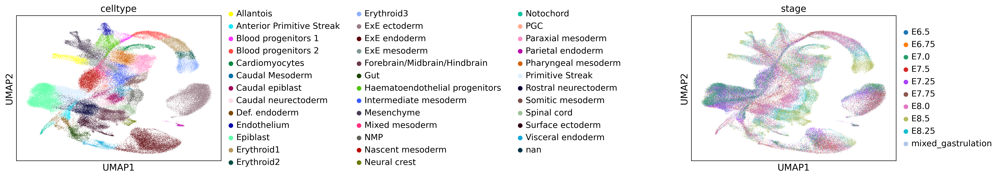

In [7]:
sc.pl.umap(mgd, color =['celltype','stage'], wspace = 2)

In [8]:
mgd_subset = mgd[mgd.obs['stage'].isin(['E7.0','E7.25','E7.5','E7.75','E8.0'])]

### remove the non anotated cells

mgd_subset = mgd_subset[~mgd_subset.obs.celltype.isin(["nan"])].copy()

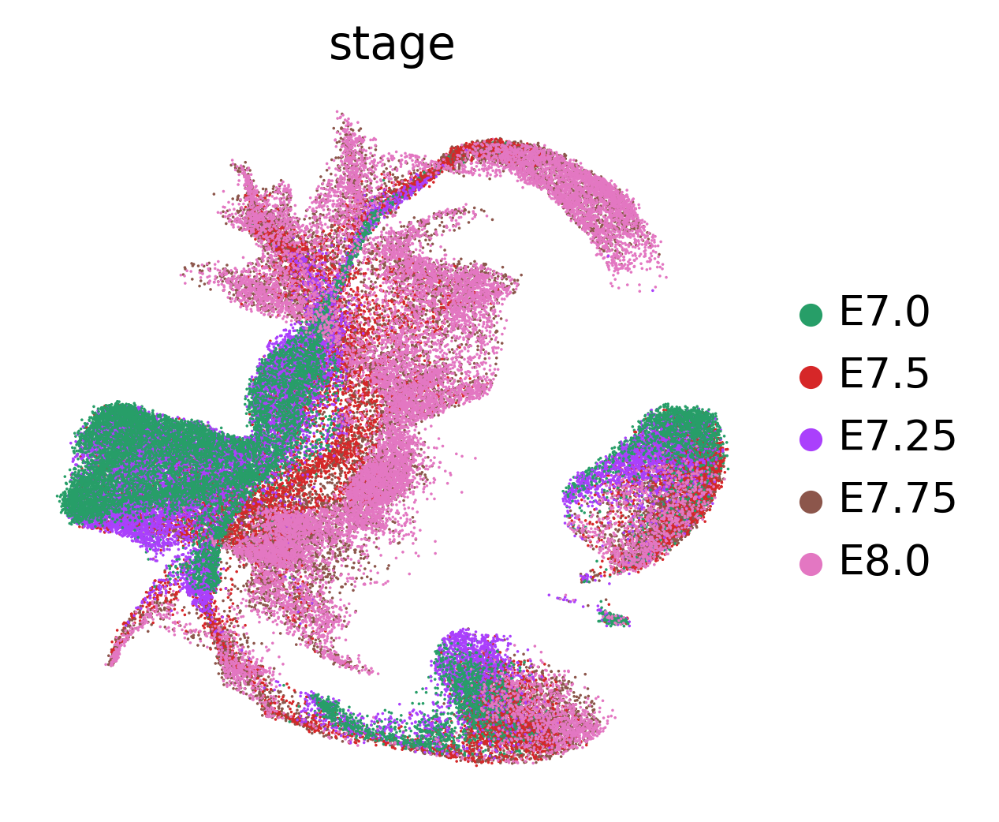

In [9]:
sc.pl.umap(mgd_subset, color =['stage'], size = 3, frameon=False, save = 'mgd_umap_e7-8.svg')

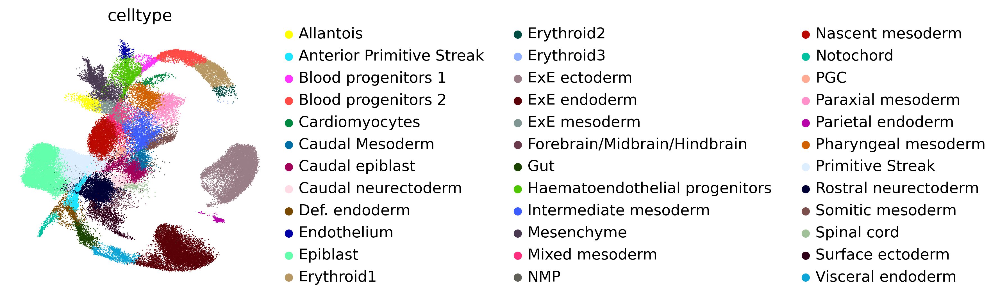

In [10]:
sc.pl.umap(mgd_subset, color =['celltype'], size = 3, frameon=False, save = 'mgd_umap_e7-8_orig_annotations.svg')

## to reduce the training complexity I am merging similar cell types in one category

In [11]:
# Temporarily convert 'celltype' to string for modification
mgd_subset.obs['celltype'] = mgd_subset.obs['celltype'].astype(str)

# Make the replacements
mgd_subset.obs['celltype'][mgd_subset.obs['celltype'].isin(['Blood progenitors 1', 'Blood progenitors 2'])] = 'Blood progenitors'
mgd_subset.obs['celltype'][mgd_subset.obs['celltype'].isin(['Erythroid1', 'Erythroid2','Erythroid3'])] = 'Erythroid'
mgd_subset.obs['celltype'][mgd_subset.obs['celltype'].isin(['Nascent mesoderm', 'Paraxial mesoderm', 'Intermediate mesoderm', 'Pharyngeal mesoderm',
                                             'Somitic mesoderm', 'Mixed mesoderm', 'Caudal Mesoderm'])] = 'Mesoderm'
mgd_subset.obs['celltype'][mgd_subset.obs['celltype'].isin(['Visceral endoderm', 'Parietal endoderm'])] = 'Early endoderm'

# Convert back to 'category' after all modifications
mgd_subset.obs['celltype'] = mgd_subset.obs['celltype'].astype('category')



/scratch/temp/kgr851/ipykernel_3326863/944030825.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mgd_subset.obs['celltype'][mgd_subset.obs['celltype'].isin(['Blood progenitors 1', 'Blood progenitors 2'])] = 'Blood progenitors'
/scratch/temp/kgr851/ipykernel_3326863/944030825.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mgd_subset.obs['celltype'][mgd_subset.obs['celltype'].isin(['Erythroid1', 'Erythroid2','Erythroid3'])] = 'Erythroid'
/scratch/temp/kgr851/ipykernel_3326863/944030825.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documen

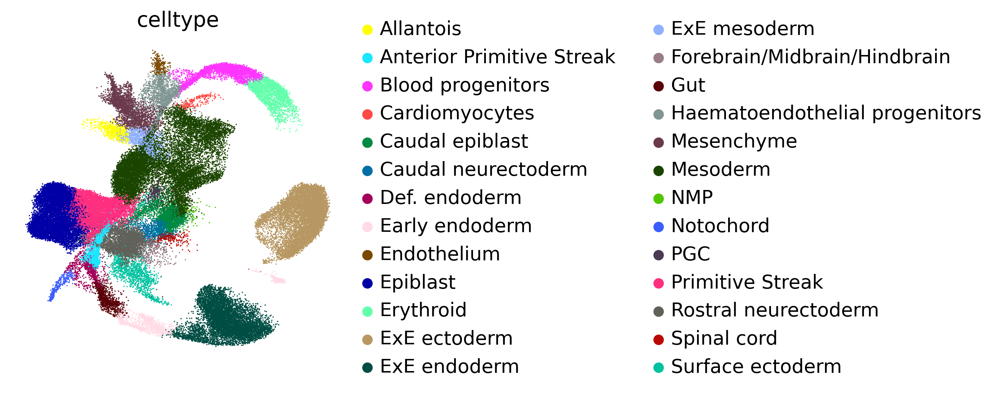

In [12]:
sc.pl.umap(mgd_subset, color =['celltype'], size = 3, frameon=False, save = 'mgd_umap_e7-8_orig_annotations_merged.svg')

In [13]:
mgd_subset.obs['celltype'].value_counts()

Mesoderm                          12416
Epiblast                          10245
ExE ectoderm                       9062
ExE endoderm                       7457
Primitive Streak                   5788
Rostral neurectoderm               4308
Blood progenitors                  2769
Mesenchyme                         2638
Erythroid                          2330
Caudal epiblast                    2069
Haematoendothelial progenitors     1658
Surface ectoderm                   1340
Early endoderm                     1277
Anterior Primitive Streak          1048
ExE mesoderm                       1029
Gut                                 912
Caudal neurectoderm                 817
Def. endoderm                       787
Allantois                           668
Notochord                           376
Forebrain/Midbrain/Hindbrain        319
PGC                                 298
Spinal cord                         265
Endothelium                         260
Cardiomyocytes                      240


# read MiSTR dataset

In [14]:
mistr = sc.read_h5ad('/scratch/kgr851/adata/all_mistr/all_mistr_mnn.h5ad')


mistr_annotated = sc.read('/scratch/kgr851/datasets/mistr_dev/mistr_all_leiden_annotated_final_gsr.h5ad')
## transfer annotations
mistr.obs['cell_type'] = mistr_annotated.obs['cell_type']

In [15]:
## since we are looking for ealiest patterning events we will only select day 0 ,1 and 2  cells

In [16]:
mistr_subset = mistr[mistr.obs['day'].isin(['day 0','day 01', 'day 02','day 05'])]

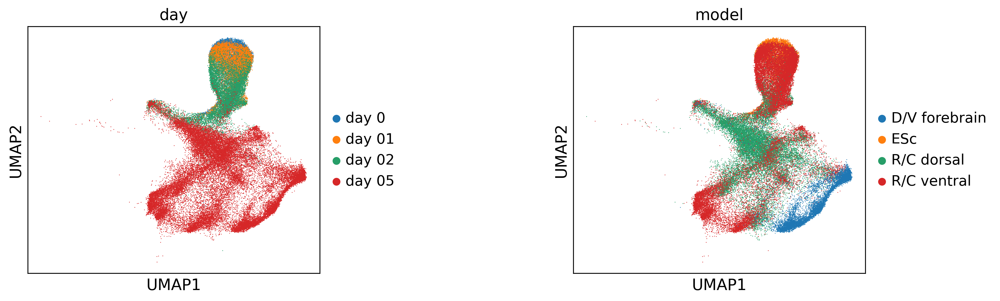

In [17]:
sc.pl.umap(mistr_subset, color = ['day','model'], wspace = 0.7)

In [18]:
mistr_subset.obs['cell_type'].value_counts()

Pluripotent cells                  19864
Prethalamus                         9464
Late epi                            7067
MHB                                 3994
Anterior neural ridge               3897
Ventral Midbrain                    3814
Proliferating midbrain              3682
Hypothalamus                        3071
Proliferating forebrain             3064
Pallium                             2188
Proliferating roof plate            1065
undefine neurons                     747
Forebrain Progenitors                279
Retinal progenitors                  113
Subpallium                            94
Cortical progenitors                  27
Retinal neurons                       20
Hindbrain                             15
Floor plate                           12
Pre optic area cortical neurons        5
Anterior floor plate                   4
Hindbrain neurons                      2
Intermediate neurons forebrain         2
FB / telencephalon                     1
Name: cell_type,

# set datasets ready for scVI

In [19]:
#############select common genes for projection analysis######
var_names = mistr_subset.var_names.intersection(mgd_subset.var_names)
mgd_subset = mgd_subset[:, var_names]
mistr_subset = mistr_subset[:, var_names]

## save umap cordinates for later 

In [20]:

mgd_subset_umap = mgd_subset.obsm['X_umap']
mistr_subset_umap = mistr_subset.obsm['X_umap']                                  

In [21]:
mgd_subset.layers["counts"] = mgd_subset.X.copy()
mgd_subset.raw = mgd_subset

In [22]:
#mistr_subset.layers["counts"] = mistr_subset.X.copy()
#mistr_subset.raw = mistr_subset

In [23]:
## add study to metadata 
mistr_subset.obs['study'] = 'mistr'
mgd_subset.obs['study'] = 'mgd'

## now concatenate 

In [24]:
adata = mgd_subset.concatenate(mistr_subset, batch_key=None)
adata

AnnData object with n_obs × n_vars = 132945 × 14738
    obs: 'barcode', 'sample', 'stage', 'sequencing.batch', 'theiler', 'doub.density', 'doublet', 'cluster', 'cluster.sub', 'cluster.stage', 'cluster.theiler', 'stripped', 'celltype', 'colour', 'umapX', 'umapY', 'haem_gephiX', 'haem_gephiY', 'haem_subclust', 'endo_gephiX', 'endo_gephiY', 'endo_trajectoryName', 'endo_trajectoryDPT', 'endo_gutX', 'endo_gutY', 'endo_gutDPT', 'endo_gutCluster', 'study', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'S.Score', 'G2M.Score', 'Phase', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.4', 'seurat_clusters', 'day', 'model', 'tissue', 'source', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'SCT_snn_res.0.6', 'SCT_snn_res.0.8', 'SCT_snn_res.1', 'SCT_snn_res.1.2', 'nCount_integrated', 'nFeature_integrated', 'ident', 'cell_type'
    var: 'gene_ids-0'
    obsm: 'X_umap'
    layers: 'counts'

In [25]:
sc.pp.normalize_total(adata, target_sum=10_000)
sc.pp.log1p(adata)

In [26]:
mistr_pred = adata[adata.obs.study.isin(["mistr"])].copy()

adata = adata[~adata.obs.study.isin(["mistr"])].copy()

In [27]:
adata.obs.dropna(axis=1, inplace=True)

In [28]:
adata.raw = adata  # keep full dimension safe
sc.pp.highly_variable_genes(
    adata,
    flavor="seurat_v3",
    n_top_genes=2_000,
    layer="counts",
    subset=True
)

# SCVI

In [31]:
import scvi

from scvi.model.utils import mde


In [32]:
scvi.model.SCVI.setup_anndata(adata, layer="counts", batch_key="stage")

In [33]:
arches_params = dict(
    use_layer_norm="both",
     use_batch_norm="none",
     encode_covariates=True,
    dropout_rate=0.2,
    n_layers=2,
)

vae = scvi.model.SCVI(adata, **arches_params)
#vae = scvi.model.SCVI(adata, n_layers=2, dispersion='gene-batch', dropout_rate=0.2, gene_likelihood="zinb", n_latent=30)
# vae = scvi.model.SCVI(adata, n_layers=2, n_latent=30)

In [34]:
vae

SCVI Model with the following params: 
n_hidden: 128, n_latent: 10, n_layers: 2, dropout_rate: 0.2, dispersion: gene, 
gene_likelihood: zinb, latent_distribution: normal
Training status: Not Trained

In [35]:
#vae.train(use_gpu=1, early_stopping=True, max_epochs=100, train_size=0.75)
vae.train(use_gpu=2, early_stopping=True, max_epochs=200, train_size=0.75,check_val_every_n_epoch=5)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2,3]


Epoch 200/200: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 200/200 [14:05<00:00,  4.23s/it, loss=1.04e+03, v_num=1]


<Axes: xlabel='epoch'>

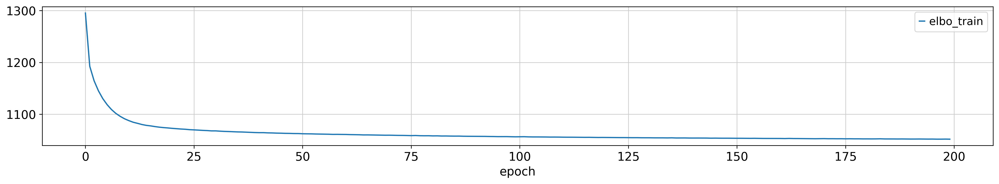

In [36]:
vae.history['elbo_train'].plot(figsize=[20,3])

In [37]:
adata.obsm["X_scVI"] = vae.get_latent_representation()
sc.pp.neighbors(adata, use_rep="X_scVI")
#sc.tl.leiden(adata)
#sc.tl.umap(adata)

adata.obsm["X_scVI"] = vae.get_latent_representation()
adata.obsm["X_mde"] = mde(adata.obsm["X_scVI"])

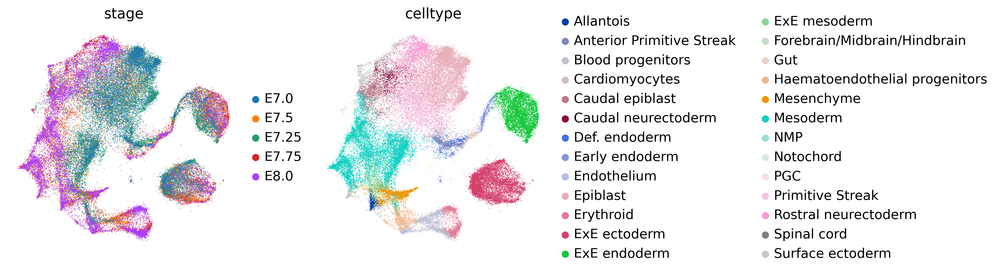

In [38]:
sc.pl.embedding(adata, basis="X_mde", color=["stage", "celltype"], frameon=False)

In [39]:
vae.save("/scratch/kgr851/home/dataset_comparision/with_mbd/models/03_model", overwrite=True)

## scanvi 

In [40]:
adata.obs["labels_scanvi"] = adata.obs["celltype"].values

In [41]:
lvae_scan = scvi.model.SCANVI.from_scvi_model(vae, unlabeled_category="Unknown", labels_key="labels_scanvi")

In [42]:
lvae_scan

ScanVI Model with the following params: 
unlabeled_category: Unknown, n_hidden: 128, n_latent: 10, n_layers: 2, dropout_rate: 0.2, 
dispersion: gene, gene_likelihood: zinb
Training status: Not Trained

In [43]:
lvae_scan.train(max_epochs=300,early_stopping=True, n_samples_per_label=100, use_gpu=2)
#lvae_scan.train(
#    max_epochs=30,              # Increase max_epochs if the model is still improving.
#    n_samples_per_label=100,    # Keep this as is, or adjust based on your label distribution.
#    check_val_every_n_epoch=5,  # Validate every 5 epochs to monitor progress.
#    train_size=0.9,             # Keep training size the same if the dataset distribution is consistent.
#    validation_size=0.1,        # This should complement train_size.
#    batch_size=128,             # Keep the batch size consistent, adjust if memory issues arise.
#    use_gpu=True,               # Keep using GPU for faster training.
#    plan_kwargs=None             # Add any specific parameters for training if needed.
#)


INFO     Training for 300 epochs.                                                            


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2,3]


Epoch 300/300: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [46:32<00:00,  9.31s/it, loss=1.16e+03, v_num=1]


<Axes: xlabel='epoch'>

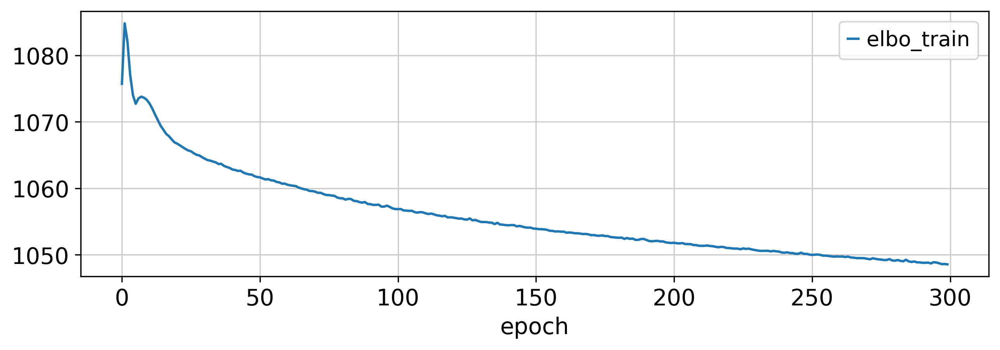

In [44]:
lvae_scan.history['elbo_train'].plot(figsize=[10,3])

In [45]:
adata.obsm["X_scANVI"] = lvae_scan.get_latent_representation()
sc.pp.neighbors(adata, use_rep="X_scANVI")
#sc.tl.leiden(adata)
#sc.tl.umap(adata)

adata.obsm["X_mde_2"] = mde(adata.obsm["X_scANVI"])

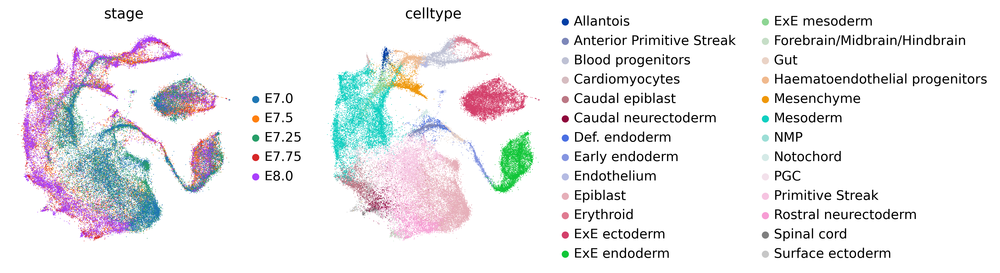

In [46]:
sc.pl.embedding(adata, basis="X_mde_2", color=["stage", "celltype"], frameon=False)

In [47]:
#del adata.obs['doublet']

In [48]:
#del adata.obs['stripped']

In [49]:
lvae_scan.save("/scratch/kgr851/home/dataset_comparision/with_mbd/models/03_model_scanvi",
               overwrite=True)

In [50]:
## time to train query

In [31]:
scvi.model.SCVI.prepare_query_anndata(mistr_pred,"/scratch/kgr851/home/dataset_comparision/with_mbd/models/03_model_scanvi")

#scvi.model.SCVI.prepare_query_anndata(mistr_pred,lvae_scan)

INFO     File                                                                                
         /scratch/kgr851/home/dataset_comparision/with_mbd/models/03_model_scanvi/model.pt   
         already downloaded                                                                  
INFO     Found 100.0% reference vars in query data.                                          


In [32]:
mistr_pred

AnnData object with n_obs × n_vars = 62491 × 2000
    obs: 'barcode', 'sample', 'stage', 'sequencing.batch', 'theiler', 'doub.density', 'doublet', 'cluster', 'cluster.sub', 'cluster.stage', 'cluster.theiler', 'stripped', 'celltype', 'colour', 'umapX', 'umapY', 'haem_gephiX', 'haem_gephiY', 'haem_subclust', 'endo_gephiX', 'endo_gephiY', 'endo_trajectoryName', 'endo_trajectoryDPT', 'endo_gutX', 'endo_gutY', 'endo_gutDPT', 'endo_gutCluster', 'study', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'S.Score', 'G2M.Score', 'Phase', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.4', 'seurat_clusters', 'day', 'model', 'tissue', 'source', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'SCT_snn_res.0.6', 'SCT_snn_res.0.8', 'SCT_snn_res.1', 'SCT_snn_res.1.2', 'nCount_integrated', 'nFeature_integrated', 'ident', 'cell_type'
    var: 'gene_ids-0'
    uns: 'log1p'
    obsm: 'X_umap'
    layers: 'counts'

In [33]:
mistr_pred_backup = mistr_pred.copy()

In [34]:
mistr_pred = mistr_pred_backup.copy()

In [35]:
mistr_pred.obs.dropna(axis=1, inplace=True)

In [36]:
mistr_pred.obs['stage'] = mistr_pred.obs['day']

In [38]:
vae_q = scvi.model.SCANVI.load_query_data(mistr_pred, "/scratch/kgr851/home/dataset_comparision/with_mbd/models/03_model_scanvi")

#vae_q = scvi.model.SCANVI.load_query_data(mistr_pred, lvae_scan)

INFO     File                                                                                
         /scratch/kgr851/home/dataset_comparision/with_mbd/models/03_model_scanvi/model.pt   
         already downloaded                                                                  


In [39]:
vae_q.train(max_epochs=30, plan_kwargs=dict(weight_decay=0.0), use_gpu=True, check_val_every_n_epoch=5)

INFO     Training for 30 epochs.                                                             


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2,3]


Epoch 30/30: 100%|████████████████████████████████████| 30/30 [03:24<00:00,  6.81s/it, loss=1.14e+03, v_num=1]


<Axes: xlabel='epoch'>

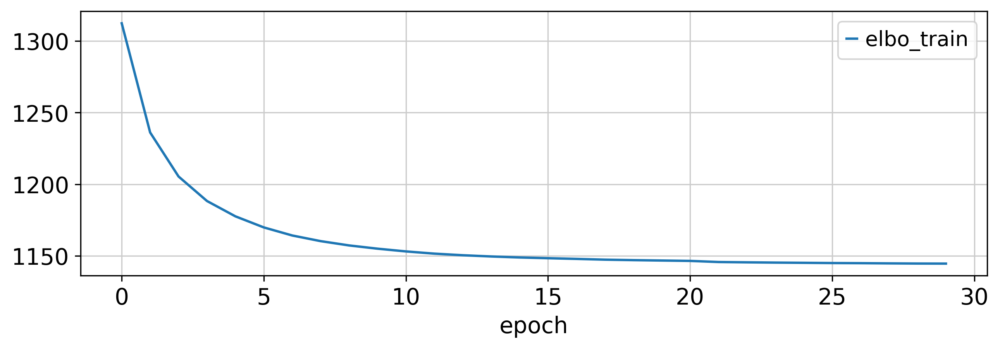

In [40]:
vae_q.history['elbo_train'].plot(figsize=[10,3])

In [41]:
mistr_pred.obsm["X_scANVI"] = vae_q.get_latent_representation()
mistr_pred.obsm["X_mde"] = mde(mistr_pred.obsm["X_scANVI"])

In [42]:
mistr_pred.obs["predictions"] = vae_q.predict()

In [ ]:
mistr_pred.obsm["X_scANVI"] = vae_q.get_latent_representation()

sc.pp.neighbors(mistr_pred, use_rep="X_scANVI")
sc.tl.draw_graph(mistr_pred)

In [ ]:
mistr_pred

In [ ]:
sc.pl.embedding(mistr_pred, basis='X_draw_graph_fa', color=["day"], frameon=False ,wspace = 0.5, legend_fontsize = 6)

In [29]:
### reacctach umap 

#adata.obsm['X_umap'] = mgd_subset.obsm['X_umap']
mistr_pred.obsm['X_umap'] = mistr_subset.obsm['X_umap']      

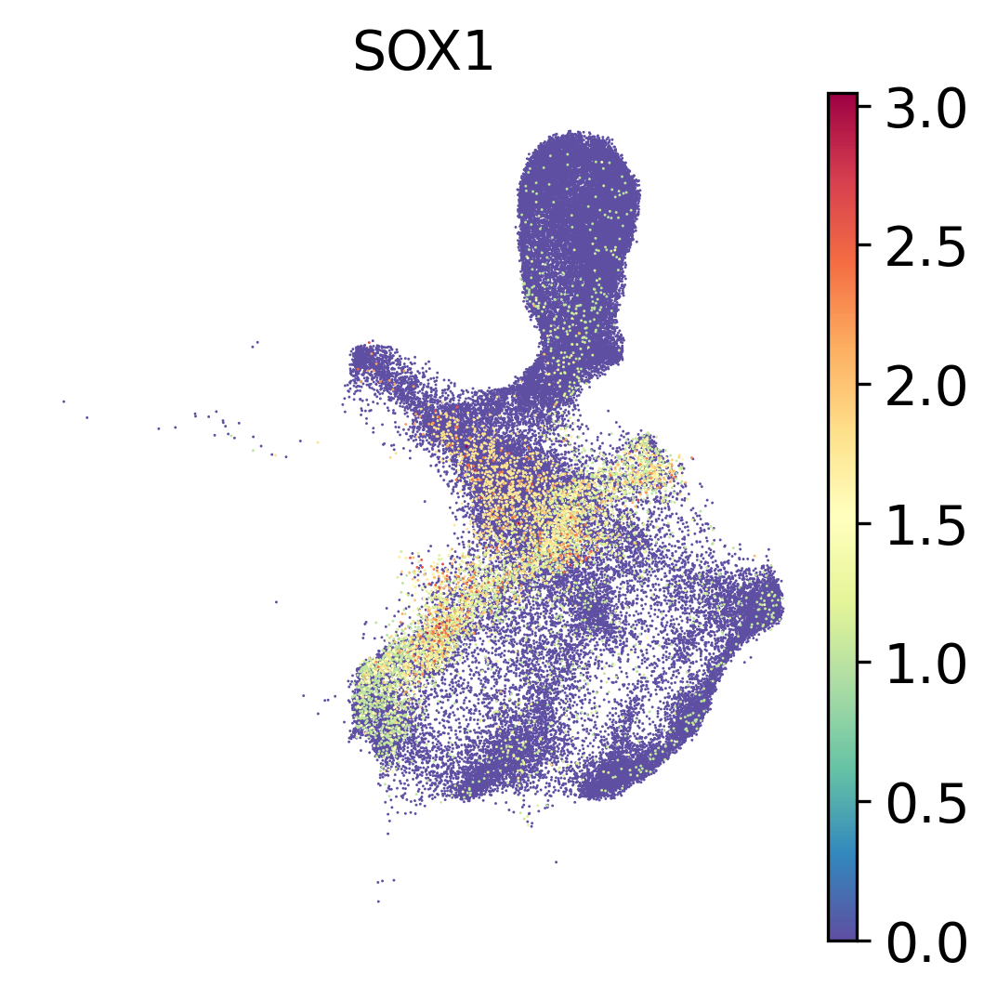

In [43]:
sc.pl.embedding(mistr_pred, basis='X_umap', color=["SOX1"], 
                frameon=False ,wspace = 0.5, legend_fontsize = 6,color_map = 'Spectral_r',
                save = 'mistr_pred_mgd_d0-5_SOX1.svg')

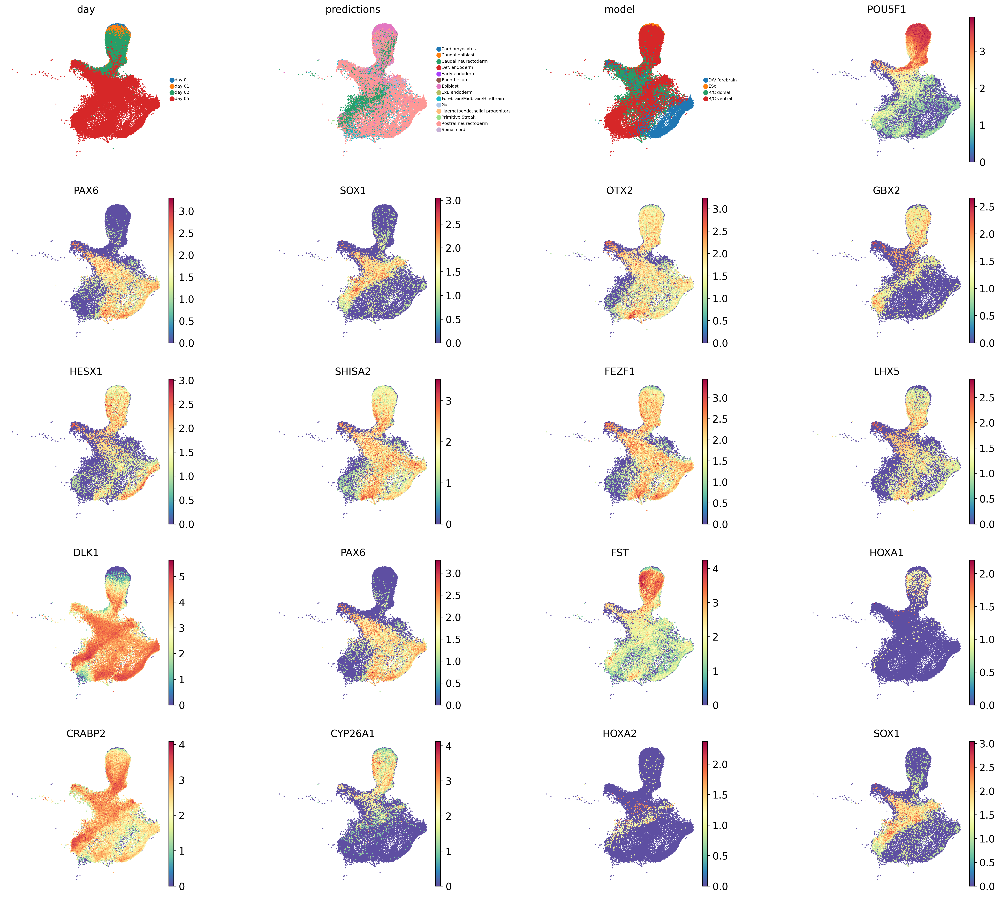

In [50]:
sc.pl.embedding(mistr_pred, basis='X_umap', color=["day",'predictions','model','POU5F1','PAX6',
                                                   'SOX1','OTX2','GBX2',
                                                   'HESX1','SHISA2',
                                                   'FEZF1','LHX5','DLK1','PAX6',
                                                  'FST','HOXA1','CRABP2','CYP26A1',
                                                   'HOXA2','SOX1'],color_map = 'Spectral_r', 
                frameon=False ,wspace = 0.5,size = 10 ,legend_fontsize = 6)

In [ ]:
sc.pl.embedding(mistr_pred, basis="X_mde", color=["day", "predictions"], frameon=False, wspace = 0.5, legend_fontsize = 6)

In [ ]:
sc.pl.embedding(mistr_pred, basis='X_draw_graph_fa', color=["cell_type", "predictions"], frameon=False, wspace = 0.5, legend_fontsize = 6)

In [ ]:
sc.pl.embedding(mistr_pred, basis="X_mde", color=['OTX2','GBX2'], frameon=False, wspace = 0.5, legend_fontsize = 6,legend_loc = 'on data')

In [ ]:
mistr_pred.obs.groupby('cell_type').apply(len)

In [ ]:
df = mistr_pred.obs.groupby(['cell_type', 'predictions']).size().unstack()\
    .loc[['Pluripotent cells','Early hypothalamus','Proliferating midbrain','Late epi','undefine neurons']]
df.to_csv('day1_2_pred_mgd.csv')

display(df)
ax = df.plot.bar(figsize=[10, 5])
ax.legend(bbox_to_anchor=(1.0, 1.0))
ax.plot()
#plt.pyplot.savefig("mistr_hbd_predictionbased on tissue_anno.svg", dpi=150, bbox_inches = "tight")

predictions,Cardiomyocytes,Caudal epiblast,Caudal neurectoderm,Def. endoderm,Early endoderm,Endothelium,Epiblast,ExE endoderm,Forebrain/Midbrain/Hindbrain,Gut,Haematoendothelial progenitors,Primitive Streak,Rostral neurectoderm,Spinal cord
day,,,,,,,,,,,,,,
day 0,2,0,21,0,0,0,7201,0,229,1,0,30,636,77
day 01,0,20,1211,0,0,0,5213,0,204,0,0,113,2767,392
day 02,0,42,2021,0,0,0,906,0,1485,0,0,79,5634,935
day 05,8,3,4855,13,2,1,979,1,2973,9,18,65,23649,696


[]

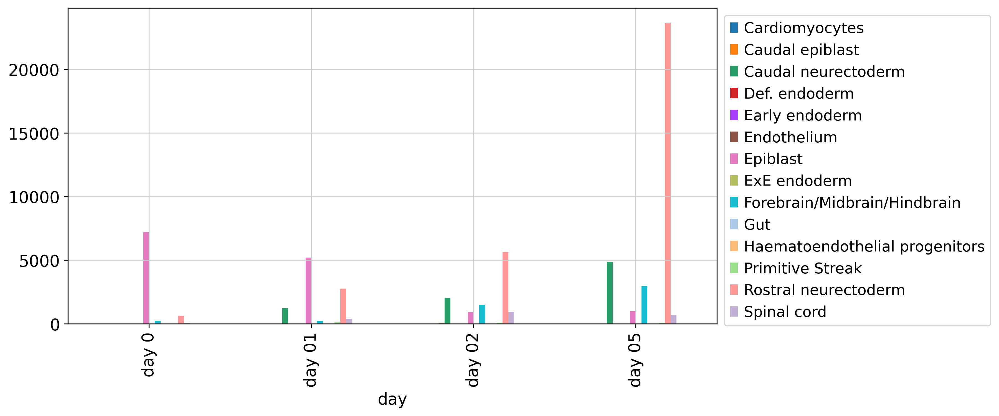

In [83]:
df = mistr_pred.obs.groupby(['day', 'predictions']).size().unstack()\
    .loc[['day 0','day 01','day 02','day 05']]
df.to_csv('day1_5_pred_mgd.csv')

display(df)
ax = df.plot.bar(figsize=[10, 5])
ax.legend(bbox_to_anchor=(1.0, 1.0))
ax.plot()
#plt.pyplot.savefig("mistr_hbd_predictionbased on tissue_anno.svg", dpi=150, bbox_inches = "tight")

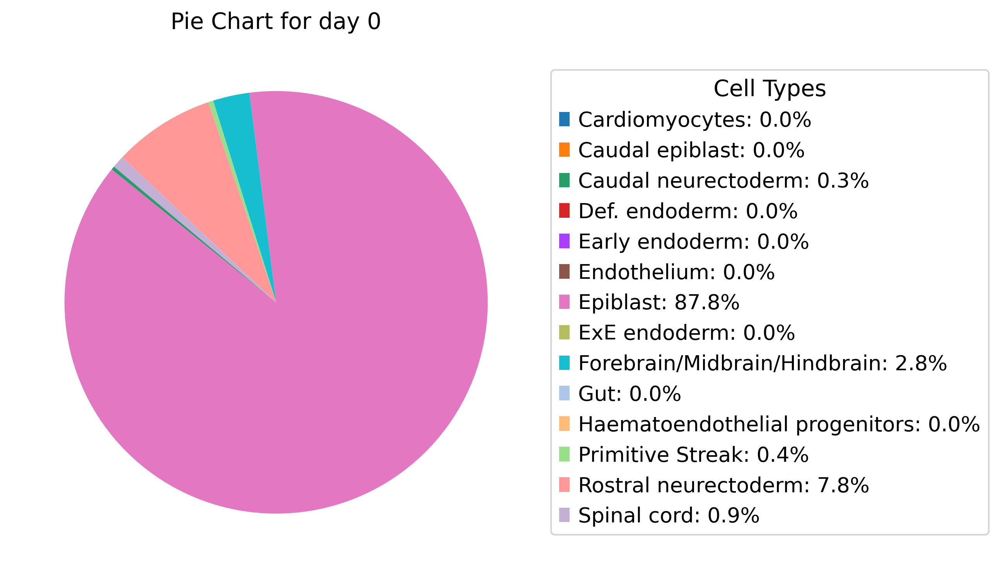

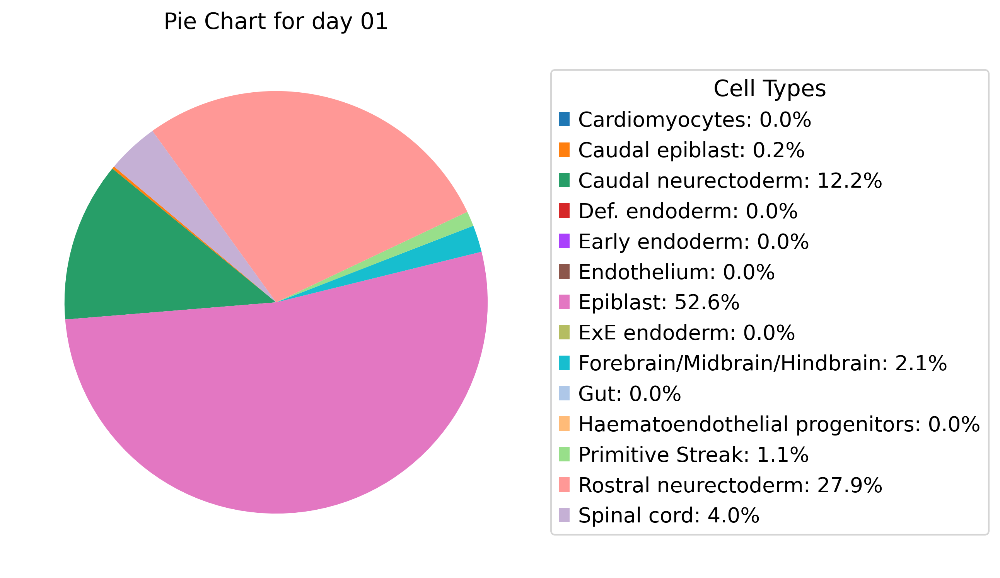

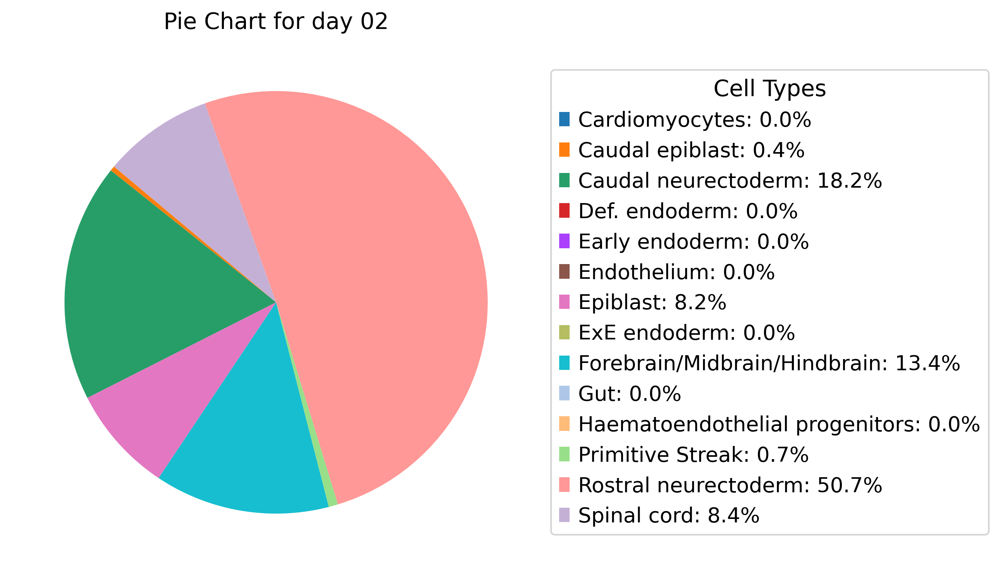

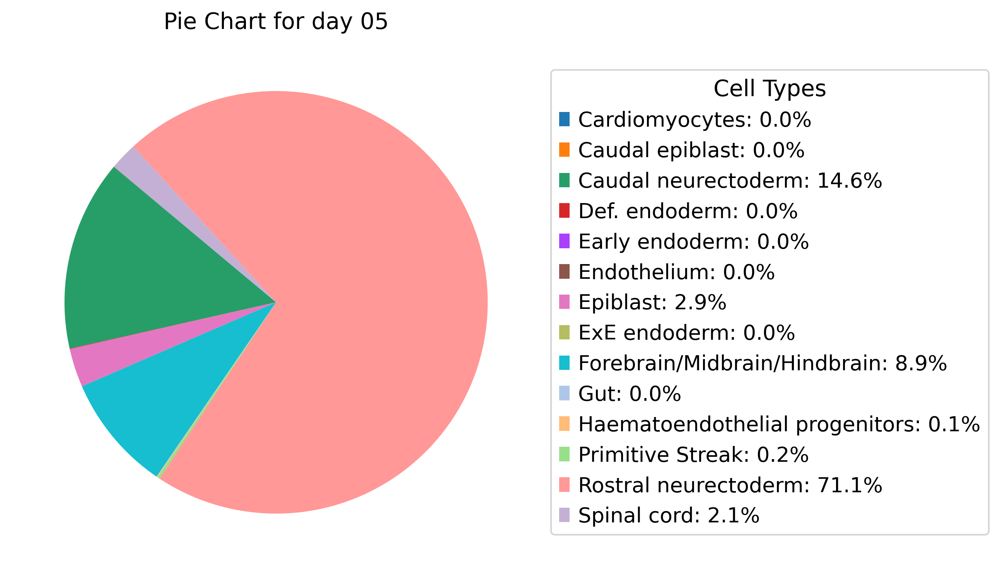

In [89]:
for i, (time_point, data) in enumerate(df.iterrows()):
    explode = [0.1 if cell_type == 'CellType1' else 0 for cell_type in data.index]
    plt.figure(figsize=(6, 6))
    wedges, texts, autotexts = plt.pie(data, labels=None, autopct='', startangle=140 ,explode=explode)
    plt.setp(texts, size=8, weight="bold")  # Set font size for legends

    # Calculate percentages for wedges and display them as legends on the side
    total = sum(data)
    legend_labels = [f'{cell_type}: {value / total * 100:.1f}%' for cell_type, value in zip(data.index, data)]
    plt.legend(wedges, legend_labels, title='Cell Types', loc='center left', bbox_to_anchor=(1, 0.5))
    plt.title(f'Pie Chart for {time_point}')
    
    # Save the plot as an SVG file
    plt.savefig(f"mgd_gastrulation_mistr_mapping_{i}.svg", dpi=150, bbox_inches="tight")
    
    # Close the current plot to release memory and resources
    #plt.close()


In [ ]:
#mistr_pred.obsm["X_scANVI"] = vae_q.get_latent_representation()
mistr_pred.obsm["X_scANVI"] = vae_q.get_latent_representation()
mistr_pred.obs['SCANVI_PREDICTIONS_KEY'] = vae_q.predict()

# subset epiblast, caudal epiblast, Rostral neurectoderm,Caudal neurectoderm from mouse

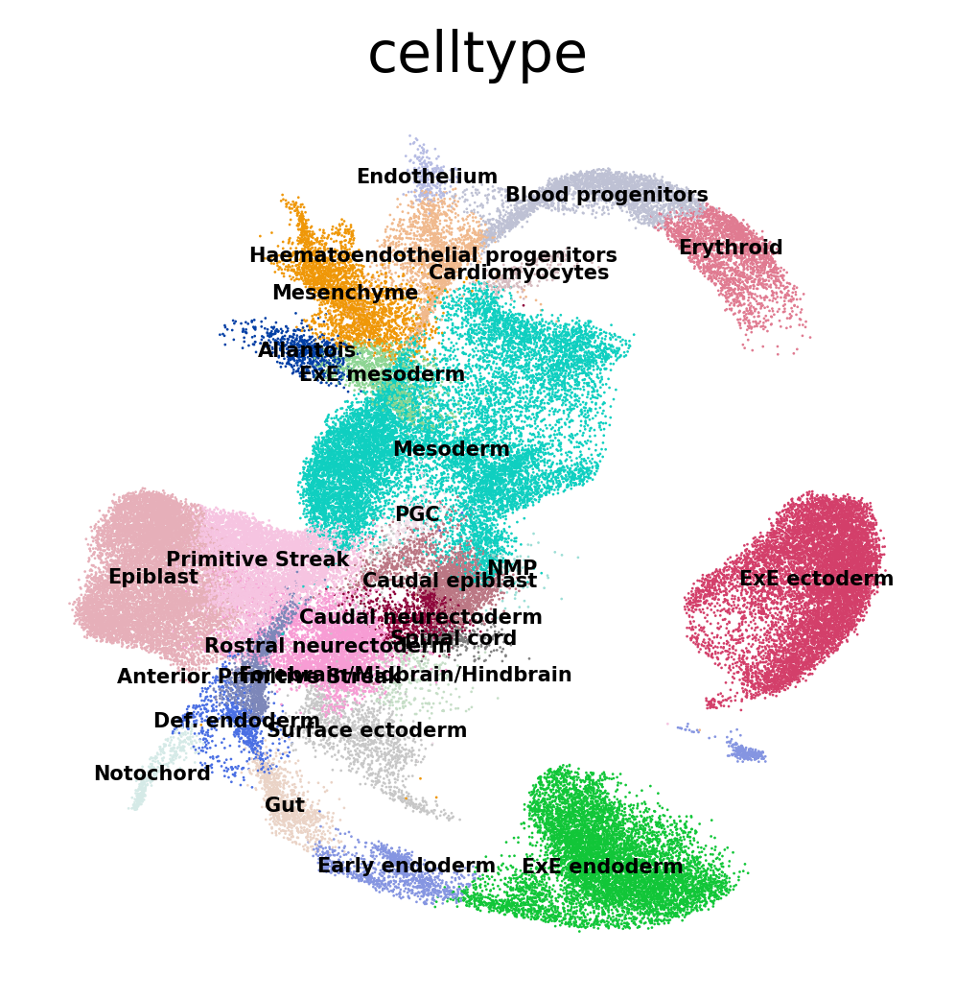

In [55]:
sc.pl.umap(adata, color = 'celltype',legend_loc = 'on data',legend_fontsize = 5,frameon = False)

In [56]:
mgd_early_patterning = adata[adata.obs['celltype'].isin(['Epiblast','Caudal epiblast',
                                                  'Rostral neurectoderm','Caudal neurectoderm'])]

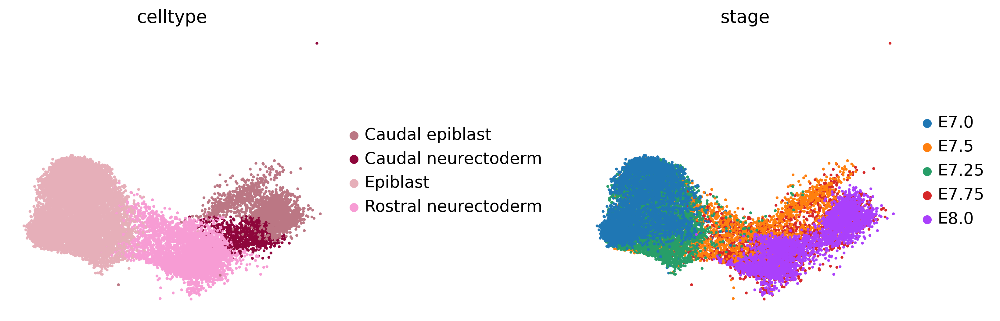

In [58]:
sc.pl.umap(mgd_early_patterning, color =['celltype','stage'], size = 20,wspace = 0.6,frameon=False)

In [70]:
# List of genes to plot
genes = ['POU5F1','NANOG','OTX2','GBX2','HESX1','SHISA2','FEZF1','LHX5','DLK1','PAX6',
         'FST','HOXA1','CRABP2','CYP26A1','HOXA2','SOX1']

# Loop through each gene and generate UMAP plot
for gene in genes:
    #with plt.rc_context({"figure.figsize": [10, 10]}):
        sc.pl.umap(mgd_early_patterning, color=[gene], size=10, frameon=False, color_map='Spectral_r', vmin=0.0,
                   legend_fontsize=15, legend_loc='on data',show = False ,save=f'umap_mouse_epi&neurectoderm_{gene}.png')


# subset epiblast, caudal epiblast, Rostral neurectoderm,Caudal neurectoderm from mistr pred

In [62]:
mistr_early_patterning = mistr_pred[mistr_pred.obs['predictions'].isin(['Epiblast','Caudal epiblast',
                                                  'Rostral neurectoderm','Caudal neurectoderm'])]

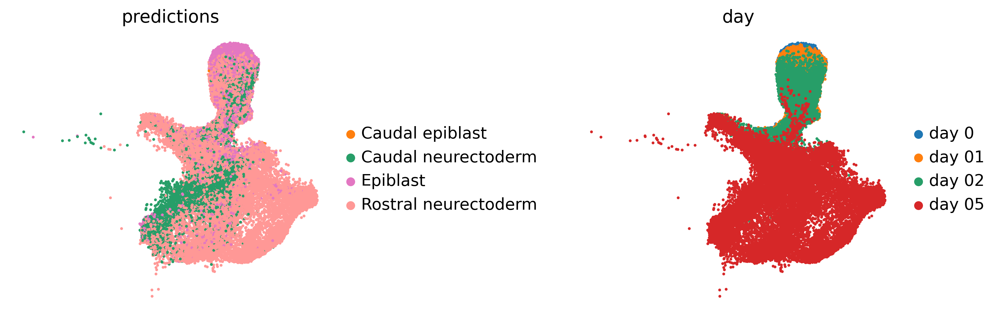

In [64]:
sc.pl.umap(mistr_early_patterning, color =['predictions','day'], size = 20,wspace = 0.6,frameon=False)

In [71]:
# List of genes to plot
genes = ['POU5F1','NANOG','OTX2','GBX2','HESX1','SHISA2','FEZF1','LHX5','DLK1','PAX6',
         'FST','HOXA1','CRABP2','CYP26A1','HOXA2','SOX1']

# Loop through each gene and generate UMAP plot
for gene in genes:
    #with plt.rc_context({"figure.figsize": [10, 10]}):
        sc.pl.umap(mistr_early_patterning, color=[gene], size=10, frameon=False, color_map='Spectral_r', vmin=0.0,
                   legend_fontsize=15, legend_loc='on data',show = False ,save=f'umap_mistr_predicted_epi&neurectoderm_{gene}.png')